In [33]:
import matplotlib.pyplot as plt 
import pandas as pd
from tabulate import tabulate
from scipy.stats import chi2_contingency


In [34]:
# Define column names
columns = [
    "age", "workclass", "fnlwgt", "education", "education_num", "marital_status",
    "occupation", "relationship", "race", "sex", "capital_gain", "capital_loss",
    "hours_per_week", "native_country", "income"
]

# Load the dataset
df = pd.read_csv("./censusIncome/adult.data", names=columns, skipinitialspace=True)

# Display the first few rows
print(tabulate(df, headers='keys', tablefmt='grid'))


+-------+-------+------------------+----------+--------------+-----------------+-----------------------+-------------------+----------------+--------------------+--------+----------------+----------------+------------------+----------------------------+----------+
|       |   age | workclass        |   fnlwgt | education    |   education_num | marital_status        | occupation        | relationship   | race               | sex    |   capital_gain |   capital_loss |   hours_per_week | native_country             | income   |
+=======+=======+==================+==========+==============+=================+=======================+===================+================+====================+========+================+================+==================+============================+==========+
|     0 |    39 | State-gov        |    77516 | Bachelors    |              13 | Never-married         | Adm-clerical      | Not-in-family  | White              | Male   |           2174 |              0 |

In [35]:
# Remove rows with missing values, ?'s indicate missing values
df = df.replace('?', pd.NA).dropna()

# Make all columns lowercase, research was done here
df = df.map(lambda x: x.lower() if isinstance(x, str) else x)

# Convert sex and income into binary values to make it easier to work with
df['sex'] = df['sex'].map({'male': 1, 'female': 0})
df['income'] = df['income'].map({'<=50k': 0, '>50k': 1})

# Print dataset and info after cleaning
print(df.info())
print(tabulate(df, headers='keys', tablefmt='grid'))


<class 'pandas.core.frame.DataFrame'>
Index: 30162 entries, 0 to 32560
Data columns (total 15 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   age             30162 non-null  int64 
 1   workclass       30162 non-null  object
 2   fnlwgt          30162 non-null  int64 
 3   education       30162 non-null  object
 4   education_num   30162 non-null  int64 
 5   marital_status  30162 non-null  object
 6   occupation      30162 non-null  object
 7   relationship    30162 non-null  object
 8   race            30162 non-null  object
 9   sex             30162 non-null  int64 
 10  capital_gain    30162 non-null  int64 
 11  capital_loss    30162 non-null  int64 
 12  hours_per_week  30162 non-null  int64 
 13  native_country  30162 non-null  object
 14  income          30162 non-null  int64 
dtypes: int64(8), object(7)
memory usage: 3.7+ MB
None
+-------+-------+------------------+----------+--------------+-----------------+-------------

sex
0    11.367818
1    31.383710
Name: income, dtype: float64


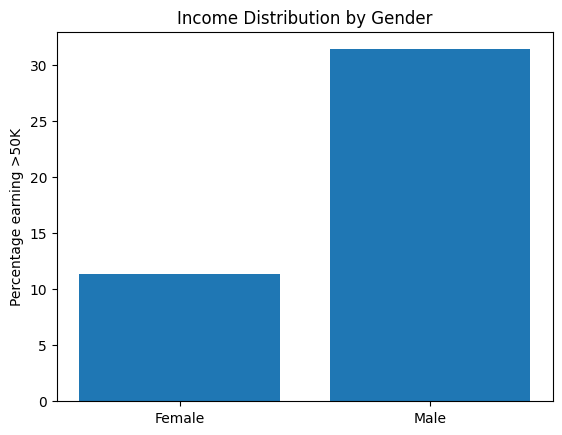

Percentage of males earning >50K: 31.38370951913641
Percentage of females earning >50K: 11.367818442036395


In [36]:
# Calculate percentage of males and females earning >50K and print it
gender_income = df.groupby("sex")["income"].mean() * 100
print(gender_income)

# Plot bar chart
plt.bar(["Female", "Male"], gender_income)
plt.ylabel("Percentage earning >50K")
plt.title("Income Distribution by Gender")
plt.show()

#print the raw percentages
print("Percentage of males earning >50K:", gender_income[1])
print("Percentage of females earning >50K:", gender_income[0])

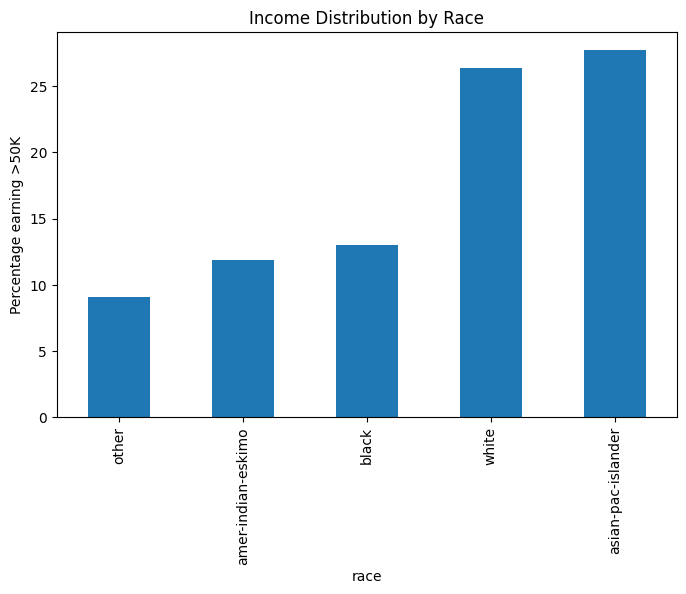

race
amer-indian-eskimo    11.888112
asian-pac-islander    27.709497
black                 12.992545
other                  9.090909
white                 26.371804
Name: income, dtype: float64


In [ ]:
# Calculate percentage of each racial group earning >50K
race_income = df.groupby("race")["income"].mean() * 100

# Plot bar chart
race_income.sort_values().plot(kind="bar", figsize=(8, 5))
plt.ylabel("Percentage earning >50K")
plt.title("Income Distribution by Race")
plt.show()

#and print the race income (in percentage)
print(race_income)


In [ ]:

# Create a contingency table for analysis
gender_contingency = pd.crosstab(df["sex"], df["income"])

# Perform Chi-Square test
chi2, p, dof, expected = chi2_contingency(gender_contingency)

print(f"Chi-Square Test for Gender Bias: p-value = {p}")
if p < 0.05:
    print("There is a statistically significant gender bias in income.")
else:
    print("No significant gender bias detected.")


Chi-Square Test for Gender Bias: p-value = 1.00155254124934e-309
There is a statistically significant gender bias in income.


In [39]:
# Create a contingency table
race_contingency = pd.crosstab(df["race"], df["income"])

# Perform Chi-Square test
chi2, p, dof, expected = chi2_contingency(race_contingency)

print(f"Chi-Square Test for Racial Bias: p-value = {p}")
if p < 0.05:
    print("There is a statistically significant racial bias in income.")
else:
    print("No significant racial bias detected.")


Chi-Square Test for Racial Bias: p-value = 1.3178285203762715e-64
There is a statistically significant racial bias in income.
